In [1]:
#standard Python packages needed
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scipy.special as sp
import os as os
import multiprocessing
from joblib import Parallel, delayed
from time import time as ti
from skimage.restoration import denoise_wavelet
import pickle
import sys
import random
import psutil
import gc

In [2]:
#custom functions file
import CoreFunctions as cf

In [3]:
# import the necessary packages for Machine Learning section
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import Conv2DTranspose
from tensorflow.keras.layers import LeakyReLU
from tensorflow.keras.layers import Activation
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Reshape
from tensorflow.keras.layers import Input
from tensorflow.keras.models import Model
from tensorflow.keras import backend as K
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.datasets import mnist
import matplotlib.pyplot as plt
import numpy as np
import argparse
import cv2
import random
import tensorflow as tf
from tensorflow.keras.models import load_model
from tensorflow.keras.callbacks import Callback
import keras
import re

2024-11-22 12:38:12.213019: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-11-22 12:38:12.225986: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-11-22 12:38:12.229930: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-11-22 12:38:12.241148: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [4]:
DataFolder = '/scratch/Recordings2/'
Model_directory = '/scratch/models/'

#Change date run, or type of run.  Used to store list of files, and add to .keras model names
DateString = '1122'

#If restarting from failure, last good .keras model saved
LastGoodModel = 0

#For 3D fingerprints, setting the width, and gap frmo one to the next
TIME_STEPS = 1200
Skips = 125
RollSize = 50

# For the file list, where in the list to start
LastSuccesfull = 0

#If False, will only run 1 set, if True, will run all remaining sets
RunTwice = True

tic = ti()
start = tic

#deletes variables after they are used, freeing memory, but makes it harder to troubleshoot
MemoryProtection = True

# If true prints interim status and variables for troubleshooting
verbose = True

#Set for memory management, some nodes can do more, but at 128GB, max is 10
FilesPerRun = 5
ConcurrentFiles = 5

# Wavelet hyper parameters:
wavelet = 'sym4'
num_scales = 32 #Due to convolutions, recomend number be divisible by 4
scale_space = 2 #skips some scales for less resolution, but higher scale view

ImageShape = [5, num_scales, int(TIME_STEPS / scale_space), 3]

#Sets up a variable, but overal declining learning rate
LR_Starting = 2e-2
LR_PeriodGrow = 5
LR_Decay = .75
LR_Expand = 2.75

# initialize the number of epochs to train for and batch size
EPOCHS = 25
BS = 32
TestSplit = 10 # 1/this many

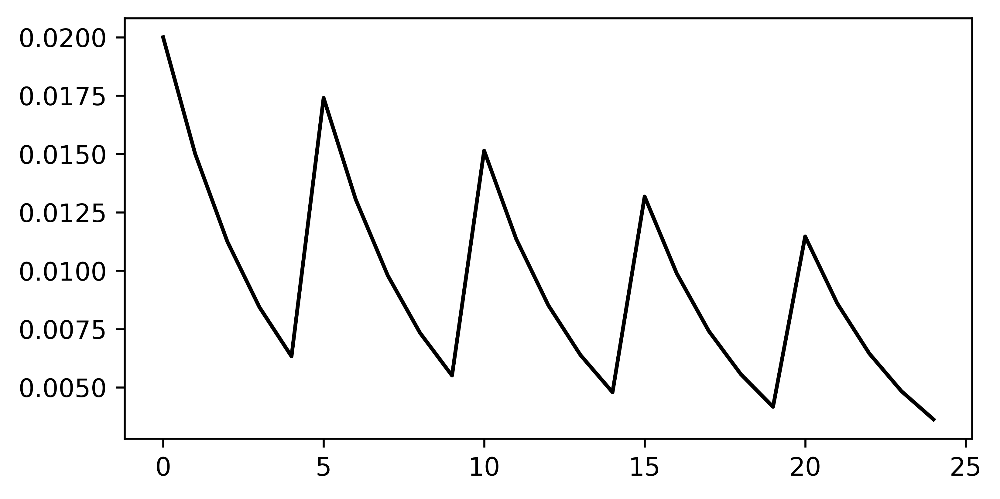

In [5]:
Lr = []
CurLR = LR_Starting
for i in range(25):
    Lr.append(CurLR)
    if (i+1) % LR_PeriodGrow == 0:
        CurLR *= LR_Expand
    else:
        CurLR *= LR_Decay

fig = plt.figure(figsize=(6,3),dpi=600)
plt.plot(Lr)
plt.show()

In [6]:
def RollingStdDevFaster(RawData, SmoothData, RollSize = 25):
    # Calculates the rolling standard deviation of a signal
    # inputs = RawData is the base singal
    #          SmoothData is the "average" that the Standard Deviation will be calculated against
    #          RollSize is the amount of data points that the Deviation will be counted for
    # output = Array of deviation at each point
    
    Diffs = RawData - SmoothData
    del RawData, SmoothData
    
    Sqs = Diffs * Diffs
    del Diffs
    
    Sqs = Sqs.tolist() 
    Sqs.extend(np.zeros(RollSize))
    mSqs = np.matrix(Sqs)
    
    for i in range(RollSize):
        Sqs.insert(0, Sqs.pop())
        mSqs = np.concatenate((np.matrix(Sqs),mSqs))
    
    sVect = mSqs.sum(axis=0)
    eVect = (mSqs!=0).sum(axis=0)
    del mSqs, Sqs
    
    VarVect = sVect / eVect
    StdDevs = np.sqrt(VarVect)
    return np.asarray(StdDevs[:-RollSize].T)

def SquelchPattern(DataSet, StallRange = 5000, SquelchLevel = 0.02, verbose = False):
    # Determins based on the Standard deviation array if a crane was moving or not.
    # inputs = Dataset: the stnadard deviation from the smooth signal array
    #          StallRange is the amount of time between high StdDevs to consider the crane stopped
    #          SquelchLevel is the StdDev level below witch the crane is considered stopped
    #          verbose is used for troubleshooting, reporting out interim variables
    # output = One array of 1s and 0s.  1 if it is moving, 0 if stationary
    
    SquelchSignal = np.ones(len(DataSet))
    if verbose:
        print(len(SquelchSignal))
        
    for i in range(len(DataSet)-2*StallRange):
        if np.average(DataSet[i:i+StallRange]) < SquelchLevel:
            SquelchSignal[i+StallRange]=0

    return SquelchSignal

def split_list_by_zeros(original_list, ones_list):
    # modified split_list_by_ones function to instead split by the zeros.
    #
    #
    # Created with Bing AI support
    #  1st request: "python split list into chunks based on value"
    #  2nd request: "I want to split the list based on the values in a second list.  Second list is all 1s and 0s.  I want all 0s removed, and each set of consequtive ones as its own item"
    #  3rd request: "That is close.  Here is an example of the two lists, and what I would want returned: original_list = [1, 2, 3, 8, 7, 4, 5, 6, 4, 7, 8, 9]
    #                ones_list =     [1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1]
    #                return: [[1, 2, 3, 8], [4, 5, 6], [8,9]]"
    #
    #This is the function that was created and seems to work on the short lists, going to use for long lists
    
    result_sublists = []
    sublist = []

    for val, is_one in zip(original_list, ones_list):
        if not is_one:
            sublist.append(val)
        elif sublist:
            result_sublists.append(sublist)
            sublist = []

    # Add the last sublist (if any)
    if sublist:
        result_sublists.append(sublist)

    return result_sublists

# Generated training sequences for use in the model.
def create_sequences(values, time_steps=TIME_STEPS, skips = Skips):
    # Splits the movement of stationary periods into 3dFP sized chuncks
    # inputs = values is the movement or stationary accelerometer data
    
    output = []
    for i in range(int((len(values) - time_steps + skips)/skips)):
        output.append(values[i*skips : (i*skips + time_steps)])
    return np.stack(output)

In [7]:
def runFile(file, M_or_S = 'M', verbose = False, small = False, r_time = False, Four_D = False, index=0, start=ti()):
    # takes a day long CSV file off accelerometer data returns a series of small chucks moving, stationary, or all.
    # inputs = file is the file name in the folder
    #          M_or_S is moving or stationary.  If not either gives both
    #          verbose prints to user interim variable data for troubleshooting
    #          small runs just a small subset of data for fast troubleshooting
    #          r_time says to include the time index as part of the output
    #          Four_D says to include the r acceleration as part of the output (used with time series ML)
    #          index allows the processing to start middle file for troubleshooting
    #          start is the time of the start, prints out time span as it runs for tracking that it is stil working
    # outputs = segmented chuncks of acceleromter data
    
    noise = verbose
    if file[-4:] == '.csv':    
        dataset = pd.read_csv(DataFolder+file, delimiter =",", header=None, engine='python',on_bad_lines='skip')
        if noise:
            print("File Read", ti()-start)
        dataset = dataset.rename(columns={0:"Day"})
        dataset = dataset.rename(columns={1:"Second"})
        dataset = dataset.rename(columns={2:"FracSec"})
        dataset = dataset.rename(columns={3:"p"})
        dataset = dataset.rename(columns={4:"h"})
        dataset = dataset.rename(columns={5:"v"})
        dataset = dataset.rename(columns={6:"Sensor"})

        if r_time:
            dataset['Second'].replace('',0)
            dataset['FracSec'].replace('',0)
            dataset.replace([np.nan, np.inf, -np.inf],0,inplace=True)
        
            dataset[['Day','Second']] = dataset[['Day','Second']].apply(lambda x: x.astype(int).astype(str).str.zfill(6))
            dataset[['FracSec']] = dataset[['FracSec']].apply(lambda x: x.astype(int).astype(str).str.zfill(4))

            dataset["timestamp"] = pd.to_datetime(dataset.Day+dataset.Second+dataset.FracSec,format='%y%m%d%H%M%S%f')
            dataset["timestamps"] = dataset["timestamp"]

        dataset["p"] = dataset.p - np.average(dataset.p)
        dataset["h"] = dataset.h - np.average(dataset.h)
        dataset["v"] = dataset.v - np.average(dataset.v)
        if Four_D:
            dataset["r"] = np.sqrt(dataset.p**2 + dataset.h**2 + dataset.v**2)

        dataset["SmoothP"] = denoise_wavelet(dataset.p, method='VisuShrink', mode='soft', wavelet_levels=3, wavelet='sym2', rescale_sigma='True')
        dataset["SmoothH"] = denoise_wavelet(dataset.h, method='VisuShrink', mode='soft', wavelet_levels=3, wavelet='sym2', rescale_sigma='True')
        dataset["SmoothV"] = denoise_wavelet(dataset.v, method='VisuShrink', mode='soft', wavelet_levels=3, wavelet='sym2', rescale_sigma='True')
        if Four_D:
            dataset["SmoothR"] = denoise_wavelet(dataset.r, method='VisuShrink', mode='soft', wavelet_levels=3, wavelet='sym2', rescale_sigma='True')

        if noise:
            print("Data Cleaned", ti()-start, len(dataset.p))

        RawData = dataset.v
        SmoothData = dataset.SmoothV
        RollSize = 25

        Diffs = RawData - SmoothData
        Sqs = Diffs * Diffs
        Sqs = Sqs.tolist() 
        Sqs.extend(np.zeros(RollSize))
        mSqs = np.matrix(Sqs)

        for i in range(RollSize):
            Sqs.insert(0, Sqs.pop())
            mSqs = np.concatenate((np.matrix(Sqs),mSqs))

        sVect = mSqs.sum(axis=0)
        eVect = (mSqs!=0).sum(axis=0)
        VarVect = sVect / eVect
        StdDevs = np.sqrt(VarVect)
        StdDevsZ = np.asarray(StdDevs)
        StdDevsZ=np.append(StdDevsZ,[0])
        StdDevsZ = np.asarray(StdDevsZ.T[:len(dataset.p)])

        if noise:
            print("Size StdDevsZ", ti()-start, np.shape(StdDevsZ))

        StdDevsZ = np.nan_to_num(StdDevsZ)

        StdDevsZ[StdDevsZ == np.inf] = 0
        StdDevsZ[StdDevsZ == -np.inf] = 0

        if noise:
            print("cleaned", ti()-start, np.shape(StdDevsZ))

        SmoothDevZ = denoise_wavelet(StdDevsZ, method='VisuShrink', mode='soft', wavelet='sym2', rescale_sigma='True')

        if noise:
            print("denoise 1", ti()-start, np.shape(StdDevsZ))

        SmoothDevZ[np.isnan(SmoothDevZ)]=0
        Max = np.max(SmoothDevZ)
        
        #calculates squelch level for when moving or not, depending on noise level in daily reading
        buckets = int(Max / 0.005) + 1
        bins = np.linspace(0,buckets*0.005,buckets+1)
        counts, bins = np.histogram(SmoothDevZ,bins=bins)

        CummCount = 0
        HalfWay = 0
        for i in range(len(counts)):
            CummCount += counts[i]
            if CummCount / len(SmoothDevZ) >= 0.5:
                if HalfWay == 0:
                    HalfWay = i

        SquelchLevel = bins[HalfWay] 
        if noise:
            print("SmoothDevz size", np.shape(SmoothDevZ))

        dataset["IsMoving"] = SquelchPattern(SmoothDevZ, 4000, SquelchLevel, verbose=noise)

        if noise:
            print("Squelch Made", ti()-start)
        #    print("Velocity Calculated.  File done: ",file)

        if M_or_S == 'S':
            df_ps = split_list_by_ones(dataset.p, dataset.IsMoving)
            df_hs = split_list_by_ones(dataset.h, dataset.IsMoving)
            df_vs = split_list_by_ones(dataset.v, dataset.IsMoving)
            if four_D:
                df_rs = split_list_by_ones(dataset.r, dataset.IsMoving)
        elif M_or_S == 'M':
            df_ps = split_list_by_zeros(dataset.SmoothP, dataset.IsMoving)
            df_hs = split_list_by_zeros(dataset.SmoothH, dataset.IsMoving)
            df_vs = split_list_by_zeros(dataset.SmoothV, dataset.IsMoving)
            if Four_D:
                df_rs = split_list_by_zeros(dataset.SmoothR, dataset.IsMoving)
        else:
            df_ps = dataset.SmoothP
            df_hs = dataset.SmoothH
            df_vs = dataset.SmoothV
            if Four_D:
                df_rs = dataset.SmoothR

        del dataset
        
        MatsSmooth = []
        for i in range(len(df_ps)):
            if Four_D:
                MatsSmooth.append(np.vstack((df_ps[i],df_hs[i],df_vs[i],df_rs[i])))
            else:
                MatsSmooth.append(np.vstack((df_ps[i],df_hs[i],df_vs[i])))
        
        if verbose:
            print("Split by ones", ti()-start)

        return MatsSmooth
    else:
        return ['fail','fail']


In [8]:
def runWrapper(file_path, M_or_S = 'M', verbose = False, small = False, r_time = False, Four_D = False, index=0, start=ti()):
    # Calls the run file function, seperated out so that when running in parallel errors can be better handled
    # inputs = file is the file name in the folder
    #          M_or_S is moving or stationary.  If not either gives both
    #          verbose prints to user interim variable data for troubleshooting
    #          small runs just a small subset of data for fast troubleshooting
    #          r_time says to include the time index as part of the output
    #          Four_D says to include the r acceleration as part of the output (used with time series ML)
    #          index allows the processing to start middle file for troubleshooting
    #          start is the time of the start, prints out time span as it runs for tracking that it is stil working
    # outputs = stack of movement matrixes
    try:
        rtrn = runFile(file_path, M_or_S, verbose, small, r_time, Four_D, index, start)
        return rtrn
    except Exception as e:
        with open('BadInputs.text', 'a') as bad_file:
            bad_file.write(file_path + '\n')
        return np.zeros((10, 10, 3))

In [9]:
def PrintWrap(Mat):
    # Makes 3D fingerprints from the movement matrixes.  In a wrapper to better handle parallelization and errors
    # inputs = Mat is the 3 by matrix of the 3 dimmensions of acceleration
    # output = 3D fingerprint
    
    localPrints = []
    lenm = np.shape(Mat)[1]
    slices = int(lenm/TIME_STEPS)
    for i in range(slices):
        temp = (cf.makeMPFast(Mat[:3,i*TIME_STEPS:(i+1)*TIME_STEPS], wvt = wavelet, scales = num_scales, spacer = scale_space, title = ''))
        localPrints.append(temp.astype(np.float32)/255.0)
    return localPrints

Using Autoencoder with Kears and Tensorflow
cite: https://pyimagesearch.com/2020/02/17/autoencoders-with-keras-tensorflow-and-deep-learning/

In [10]:
class ConvAutoencoder:
    @staticmethod
    def build(width, height, depth, filters=(32, 64), latentDim=24):
        inputShape = (height, width, depth)
        chanDim = -1
        inputs = Input(shape=inputShape)
        x = inputs

        for f in filters:
            x = Conv2D(f, (3, 3), strides=2, padding="same")(x)
            x = LeakyReLU(alpha=0.2)(x)
            x = BatchNormalization(axis=chanDim)(x)

        volumeSize = K.int_shape(x)
        print("Volume Size:", volumeSize)
        x = Flatten()(x)
        latent = Dense(latentDim)(x)

        encoder = Model(inputs, latent, name="encoder")

        latentInputs = Input(shape=(latentDim,))
        flattenedVolumeSize = int(np.prod(volumeSize[1:]))
        print("Flattened Volume Size:", flattenedVolumeSize)
        x = Dense(flattenedVolumeSize)(latentInputs)
        x = Reshape((volumeSize[1], volumeSize[2], volumeSize[3]))(x)

        for f in filters[::-1]:
            x = Conv2DTranspose(f, (3, 3), strides=2, padding="same")(x)
            x = LeakyReLU(alpha=0.2)(x)
            x = BatchNormalization(axis=chanDim)(x)

        x = Conv2DTranspose(depth, (3, 3), padding="same")(x)
        outputs = Activation("sigmoid")(x)

        decoder = Model(latentInputs, outputs, name="decoder")
        autoencoder = Model(inputs, decoder(encoder(inputs)), name="autoencoder")

        return (encoder, decoder, autoencoder)


In [11]:
def GetLatestModel(Pattern=r'3DFP_(\d{4})_(\d{3})_good\.keras'):
    # using a regular expression of the file format, looks for the last model in the series that has been saved
    # inputs = the RegEx for file name pattern
    # output = last file name in sequence

    
    # Regular expression to match the filenames
    pattern = re.compile(Pattern)
    
    # Initialize variables to track the highest numbers
    max_main_number = -1
    max_sub_number = -1
    target_file = None
    
    # Iterate over the files in the directory
    
    file_list = os.listdir(Model_directory)
    for filename in file_list:
        match = pattern.match(filename)
        if match:
            main_number = int(match.group(1))
            sub_number = int(match.group(2))
            
            # Check if this file has the highest main number
            if main_number > max_main_number: # or (main_number == max_main_number and sub_number > max_sub_number):
                max_main_number = main_number
                
    for filename in file_list:
        match = pattern.match(filename)
        if match:
            main_number = int(match.group(1))
            sub_number = int(match.group(2))
        
            if main_number==max_main_number and sub_number > max_sub_number:
                max_sub_number = sub_number
                target_file = filename
    
    return target_file
    

In [12]:
if LastSuccesfull ==0:
    files= os.listdir(DataFolder) 
    random.shuffle(files)
    with open(f'CurrentFileList{DateString}.text','w') as file:
        for item in files:
            file.write(f"{item}\n")
else:
    with open(f'CurrentFileList{DateString}.text','r') as file:
        files = file.readlines()
    files=[item.strip() for item in files]

In [13]:
#if there is no saved model, creates a new model.  If there is a saved model, opens the last known good.
if LastSuccesfull == 0:
    (encoder, decoder, autoencoder) = ConvAutoencoder.build(ImageShape[2], ImageShape[1], ImageShape[3],(64,32),32)
else:

    # If auto finding the latest model can use this, but crrently grabbing manually based on entered data
    if LastGoodModel < 0:
        target_file = GetLatestModel()
    else:
        target_file = f'3DFP_{DateString}_{str(LastGoodModel).zfill(3)}_good_ae.keras'
    
    reautoencoder = load_model(Model_directory+target_file)
    encoder = load_model(Model_directory+target_file[:-8]+'en.keras')
    decoder = load_model(Model_directory+target_file[:-8]+'de.keras')

    autoencoder_input = Input(shape=(ImageShape[1], ImageShape[2], ImageShape[3]))

    # Pass the input through the encoder and decoder
    encoded_repr = encoder(autoencoder_input)
    reconstructed = decoder(encoded_repr)

    # Create the reassembled autoencoder model
    autoencoder = Model(autoencoder_input, reconstructed)

2024-11-22 12:38:15.392654: I tensorflow/core/common_runtime/gpu/gpu_device.cc:2021] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 43598 MB memory:  -> device: 0, name: NVIDIA A40, pci bus id: 0000:21:00.0, compute capability: 8.6


Volume Size: (None, 8, 150, 32)
Flattened Volume Size: 38400


/sciclone/home/dchendrickson01/miniconda3/lib/python3.12/site-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


In [14]:
print(encoder.summary())
print(decoder.summary())
print(autoencoder.summary())


Model: "encoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 32, 600, 3)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 16, 300, 64)    │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu (LeakyReLU)         │ (None, 16, 300, 64)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 16, 300, 64)    │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 8, 150, 32)     │        18,464 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_1 (LeakyReLU)       │ (None, 8, 150, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 8, 150, 32)     │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 38400)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 32)             │     1,228,832 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,249,472 (4.77 MB)

 Trainable params: 1,249,280 (4.77 MB)

 Non-trainable params: 192 (768.00 B)

None


Model: "decoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 38400)          │     1,267,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape (Reshape)               │ (None, 8, 150, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose                │ (None, 16, 300, 32)    │         9,248 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_2 (LeakyReLU)       │ (None, 16, 300, 32)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 16, 300, 32)    │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_1              │ (None, 32, 600, 64)    │        18,496 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_3 (LeakyReLU)       │ (None, 32, 600, 64)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 32, 600, 64)    │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_2              │ (None, 32, 600, 3)     │         1,731 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation (Activation)         │ (None, 32, 600, 3)     │             0 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,297,059 (4.95 MB)

 Trainable params: 1,296,867 (4.95 MB)

 Non-trainable params: 192 (768.00 B)

None


Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 32, 600, 3)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 32)             │     1,249,472 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 32, 600, 3)     │     1,297,059 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,546,531 (9.71 MB)

 Trainable params: 2,546,147 (9.71 MB)

 Non-trainable params: 384 (1.50 KB)

None


In [15]:
opt = Adam(learning_rate=LR_Starting)
LR_Current = LR_Starting
autoencoder.compile(loss="mse", optimizer=opt)
# train the convolutional autoencoder

In [16]:

class CustomModelCheckpoint(Callback):
    def __init__(self, filepath, save_freq):
        super(CustomModelCheckpoint, self).__init__()
        self.filepath = filepath
        self.save_freq = save_freq

    def on_epoch_end(self, epoch, logs=None):
        if (epoch + 1) % self.save_freq == 0:
            self.model.save(self.filepath.format(epoch=epoch + 1))

In [17]:
checkpoint_callback = CustomModelCheckpoint(
    filepath='/scratch/models/3DFP_'+DateString+'_00_{epoch:02d}.keras',
    save_freq=3  
)

tb_callback = tf.keras.callbacks.TensorBoard(log_dir='/scratch/models/profiles/'+DateString,
                                            profile_batch='01, 125')

es_callback = keras.callbacks.EarlyStopping(monitor="loss", patience=6, mode="min")

2024-11-22 12:38:16.091522: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:103] Profiler session initializing.
2024-11-22 12:38:16.091557: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:118] Profiler session started.
2024-11-22 12:38:16.091577: I external/local_xla/xla/backends/profiler/gpu/cupti_tracer.cc:892] Profiler found 1 GPUs
2024-11-22 12:38:16.122293: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:130] Profiler session tear down.
2024-11-22 12:38:16.122410: I external/local_xla/xla/backends/profiler/gpu/cupti_tracer.cc:1036] CUPTI activity buffer flushed


Loops Needed: 214


/sciclone/home/dchendrickson01/miniconda3/lib/python3.12/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/sciclone/home/dchendrickson01/miniconda3/lib/python3.12/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


RAM after AllData: 5.3


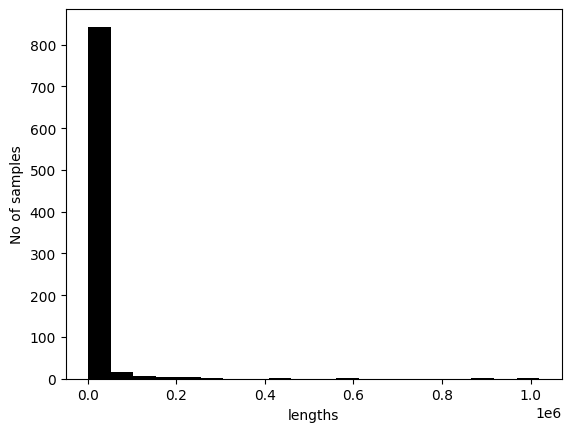

RAM after Keeps: 9.3
<class 'list'>
float32
(11415, 32, 600, 3)
RAM memory % used: 9.3


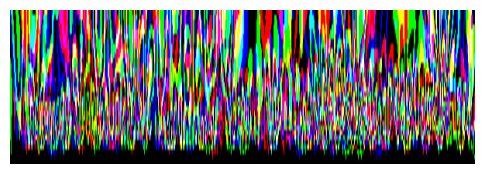

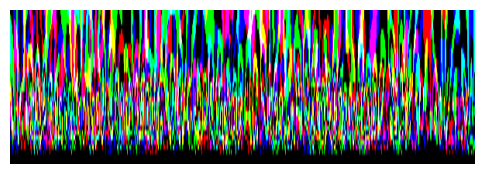

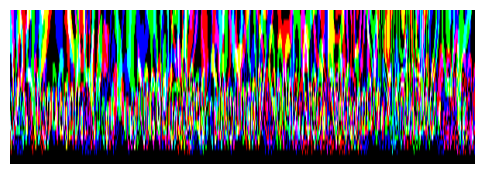

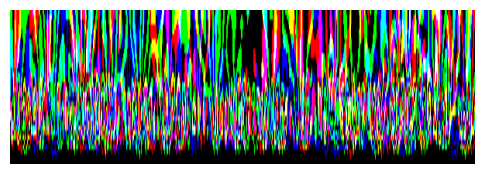

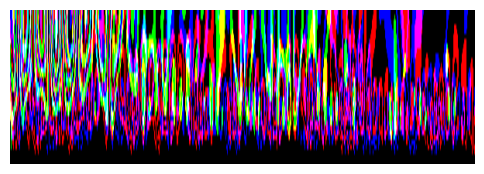

RAM after Prints: 10.9
Epoch 1/20


I0000 00:00:1732297421.908069  257869 service.cc:146] XLA service 0x14c900004520 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1732297421.908124  257869 service.cc:154]   StreamExecutor device (0): NVIDIA A40, Compute Capability 8.6
2024-11-22 12:43:41.974679: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2024-11-22 12:43:42.179680: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:531] Loaded cuDNN version 8906


 12/322 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step - loss: 0.2691

I0000 00:00:1732297426.051932  257869 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


322/322 ━━━━━━━━━━━━━━━━━━━━ 16s 28ms/step - loss: 0.2162 - val_loss: 0.2078
Epoch 2/20
322/322 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step - loss: 0.2058 - val_loss: 0.2056
Epoch 3/20
322/322 ━━━━━━━━━━━━━━━━━━━━ 5s 15ms/step - loss: 0.2045 - val_loss: 0.2041
Epoch 4/20
322/322 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step - loss: 0.2041 - val_loss: 0.2049
Epoch 5/20
322/322 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step - loss: 0.2038 - val_loss: 0.2039
Epoch 6/20
322/322 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step - loss: 0.2037 - val_loss: 0.2044
Epoch 7/20
322/322 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step - loss: 0.2033 - val_loss: 0.2039
Epoch 8/20
322/322 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step - loss: 0.2031 - val_loss: 0.2043
Epoch 9/20
322/322 ━━━━━━━━━━━━━━━━━━━━ 5s 15ms/step - loss: 0.2028 - val_loss: 0.2058
Epoch 10/20
322/322 ━━━━━━━━━━━━━━━━━━━━ 5s 15ms/step - loss: 0.2039 - val_loss: 0.2037
Epoch 11/20
322/322 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step - loss: 0.2025 - val_loss: 0.2042
Epoch 12/20
322/322 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/st

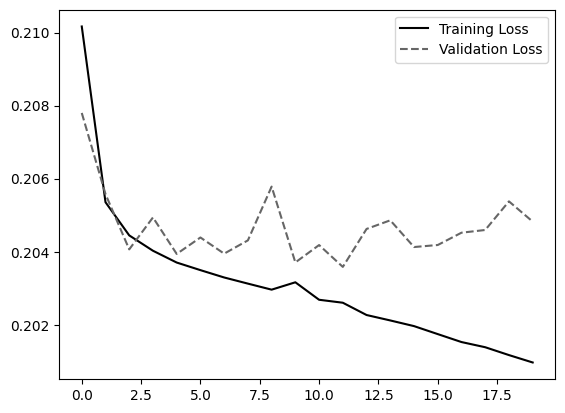

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 647ms/step


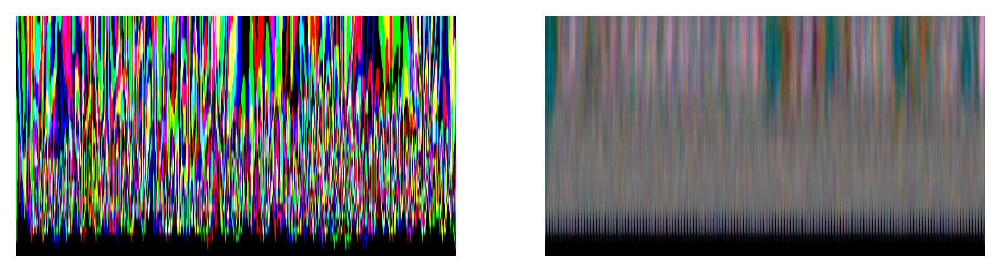

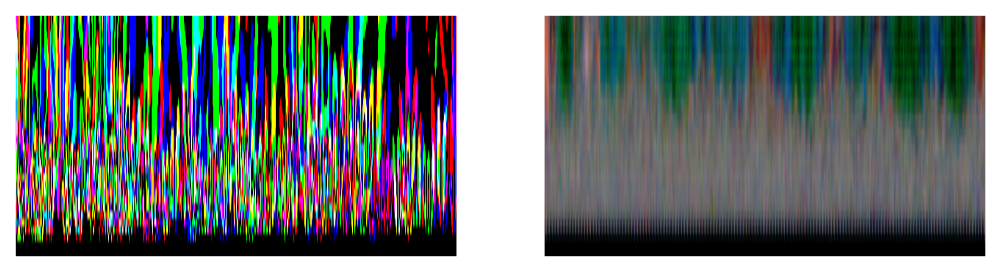

1 of 214 in 7.28 minutes. Using 10.6 of RAM


/sciclone/home/dchendrickson01/miniconda3/lib/python3.12/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/sciclone/home/dchendrickson01/miniconda3/lib/python3.12/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/sciclone/home/dchendrickson01/miniconda3/lib/python3.12/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/sciclone/home/dchendrickson01/miniconda3/lib/python3.12/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


RAM after AllData: 10.7


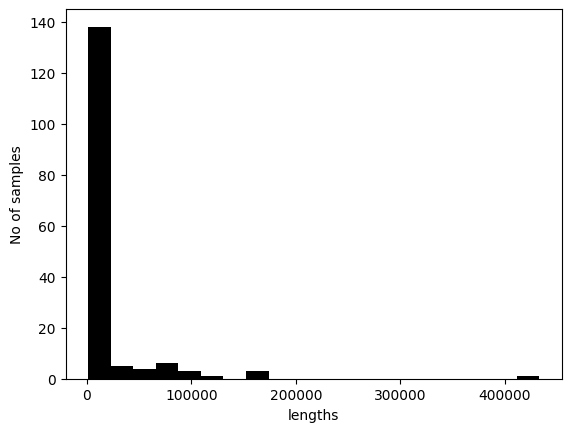

RAM after Keeps: 11.8
<class 'list'>
float32
(2474, 32, 600, 3)
RAM memory % used: 12.2


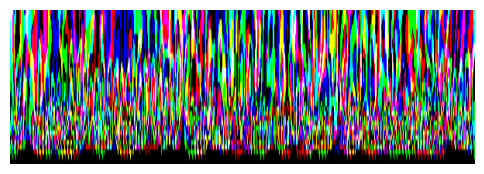

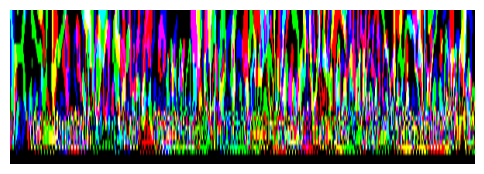

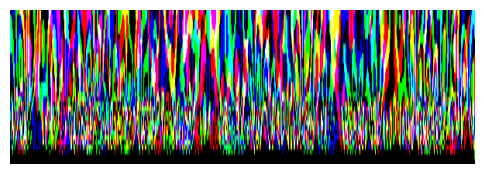

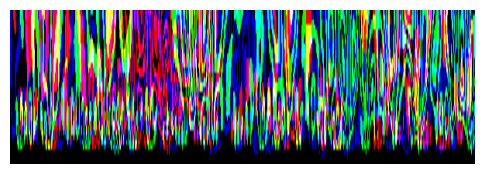

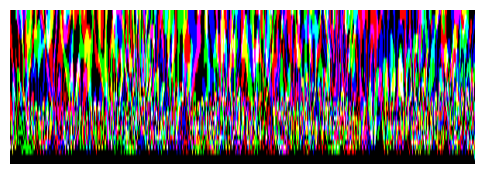

RAM after Prints: 12.0
Epoch 1/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 5s 78ms/step - loss: 0.2069 - val_loss: 0.2129
Epoch 2/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.2055 - val_loss: 0.2080
Epoch 3/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.2047 - val_loss: 0.2065
Epoch 4/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.2045 - val_loss: 0.2064
Epoch 5/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.2039 - val_loss: 0.2064
Epoch 6/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.2038 - val_loss: 0.2066
Epoch 7/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.2031 - val_loss: 0.2068
Epoch 8/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.2019 - val_loss: 0.2073
Epoch 9/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.2016 - val_loss: 0.2076
Epoch 10/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.2010 - val_loss: 0.2082
Epoch 11/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.2000 - val_loss: 0.2089
Epoch 12/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 1

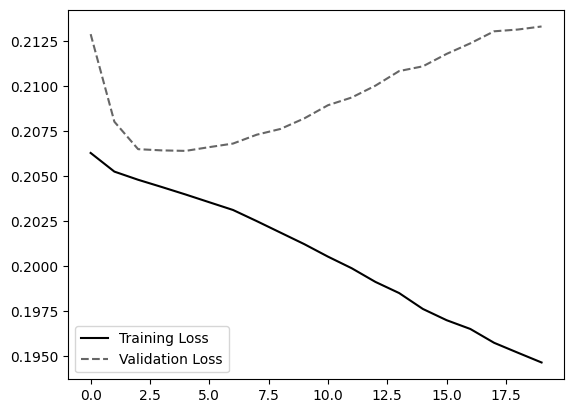

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


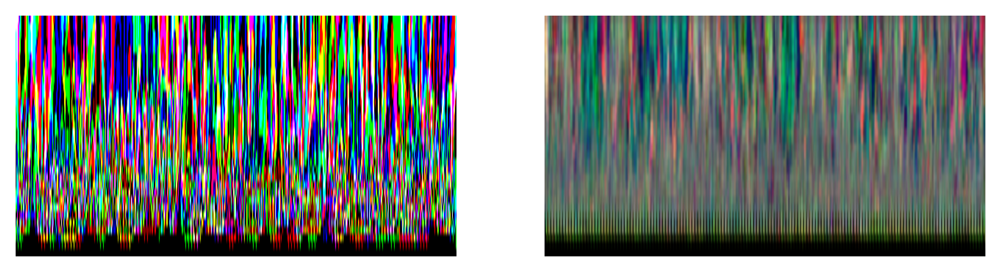

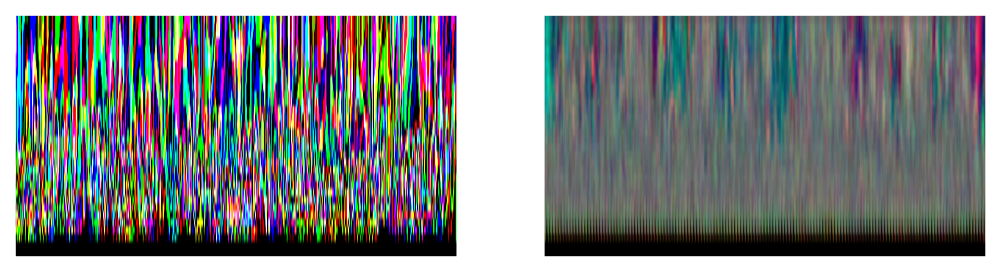

2 of 214 in 13.07 minutes. Using 13.8 of RAM
RAM after AllData: 13.9


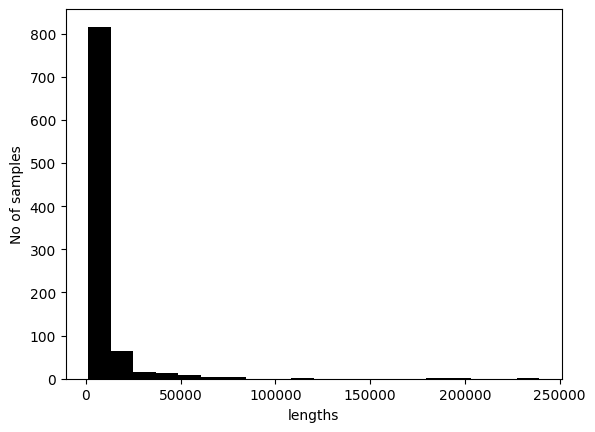

RAM after Keeps: 14.6
<class 'list'>
float32
(5848, 32, 600, 3)
RAM memory % used: 14.6


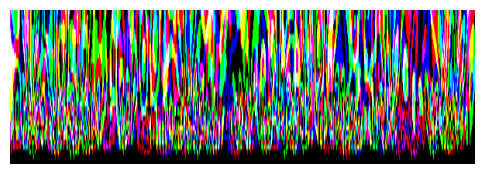

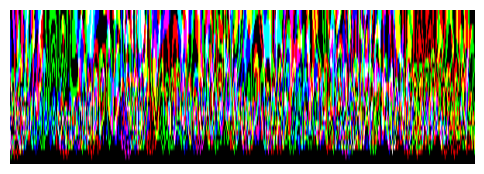

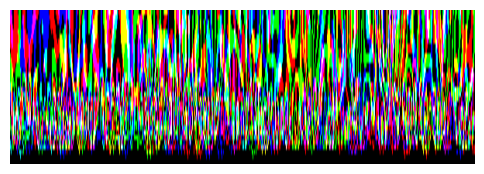

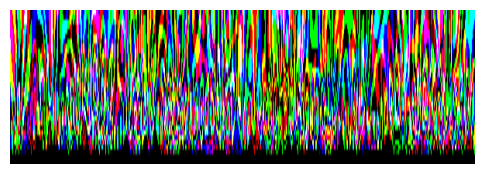

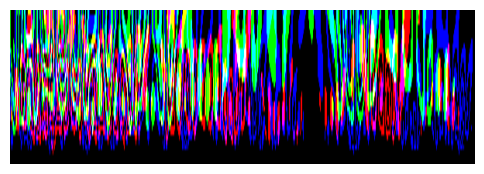

RAM after Prints: 15.5
Epoch 1/20
165/165 ━━━━━━━━━━━━━━━━━━━━ 7s 40ms/step - loss: 0.2013 - val_loss: 0.1992
Epoch 2/20
165/165 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.1996 - val_loss: 0.1986
Epoch 3/20
165/165 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.1993 - val_loss: 0.1983
Epoch 4/20
165/165 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.1989 - val_loss: 0.1985
Epoch 5/20
165/165 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.1988 - val_loss: 0.1984
Epoch 6/20
165/165 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.1988 - val_loss: 0.1983
Epoch 7/20
165/165 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.1986 - val_loss: 0.1987
Epoch 8/20
165/165 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.1983 - val_loss: 0.1985
Epoch 9/20
165/165 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.1982 - val_loss: 0.1986
Epoch 10/20
165/165 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.1974 - val_loss: 0.1987
Epoch 11/20
165/165 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.1972 - val_loss: 0.1990
Epoch 12/20
165/16

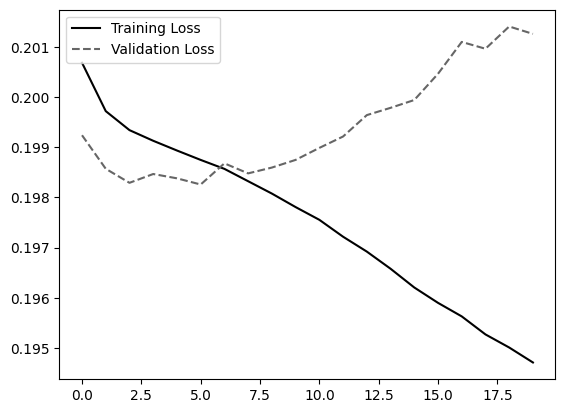

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


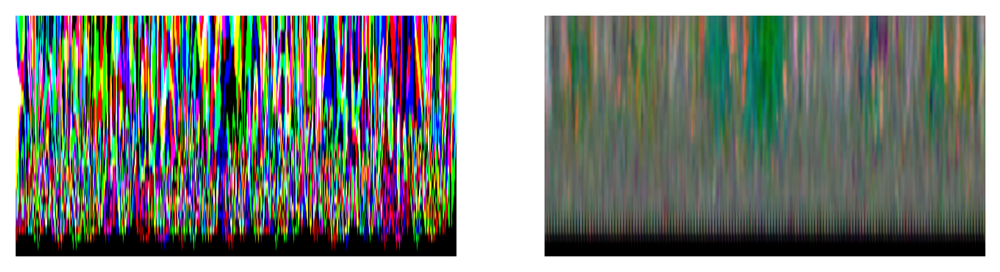

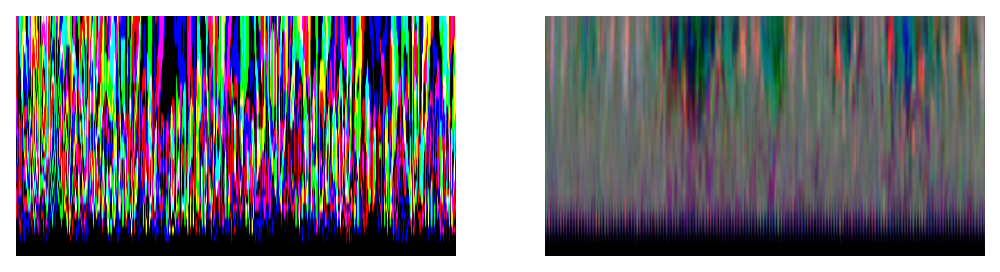

3 of 214 in 19.59 minutes. Using 14.5 of RAM
RAM after AllData: 14.5


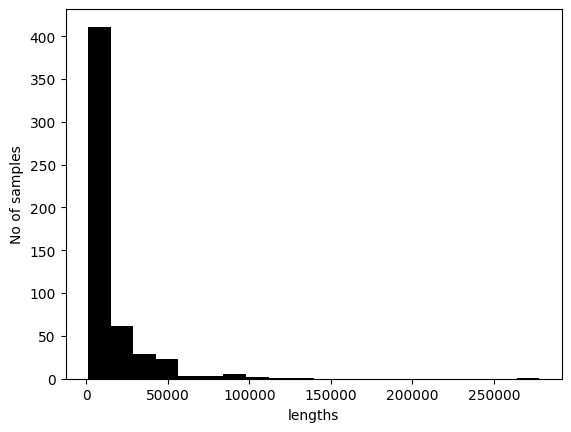

RAM after Keeps: 14.6
<class 'list'>
float32
(5936, 32, 600, 3)
RAM memory % used: 14.6


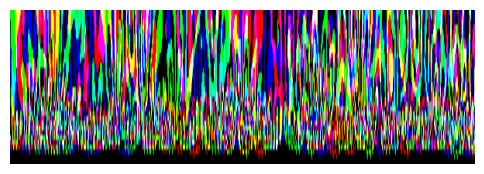

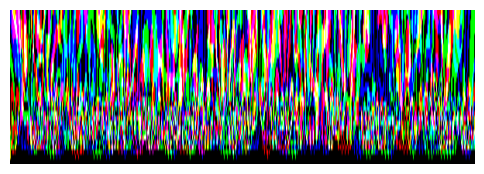

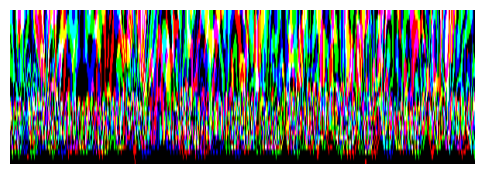

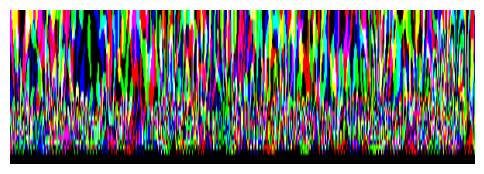

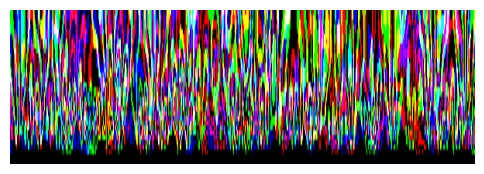

RAM after Prints: 15.6
Epoch 1/20
167/167 ━━━━━━━━━━━━━━━━━━━━ 7s 40ms/step - loss: 0.2028 - val_loss: 0.2025
Epoch 2/20
167/167 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.2012 - val_loss: 0.2015
Epoch 3/20
167/167 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.2013 - val_loss: 0.2014
Epoch 4/20
167/167 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.2016 - val_loss: 0.2014
Epoch 5/20
167/167 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - loss: 0.2010 - val_loss: 0.2013
Epoch 6/20
167/167 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.2008 - val_loss: 0.2013
Epoch 7/20
167/167 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.2008 - val_loss: 0.2014
Epoch 8/20
167/167 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.2002 - val_loss: 0.2014
Epoch 9/20
167/167 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.2000 - val_loss: 0.2019
Epoch 10/20
167/167 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.2001 - val_loss: 0.2017
Epoch 11/20
167/167 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.1993 - val_loss: 0.2019
Epoch 12/20
167/16

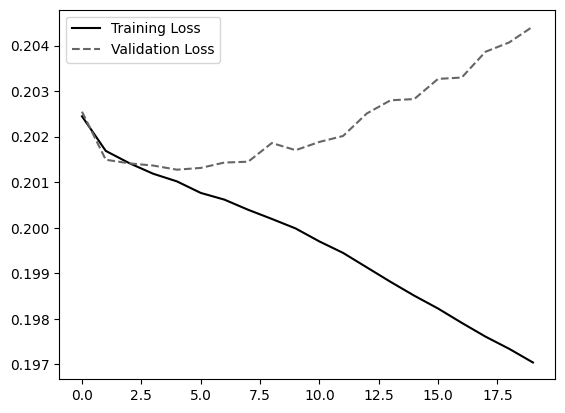

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


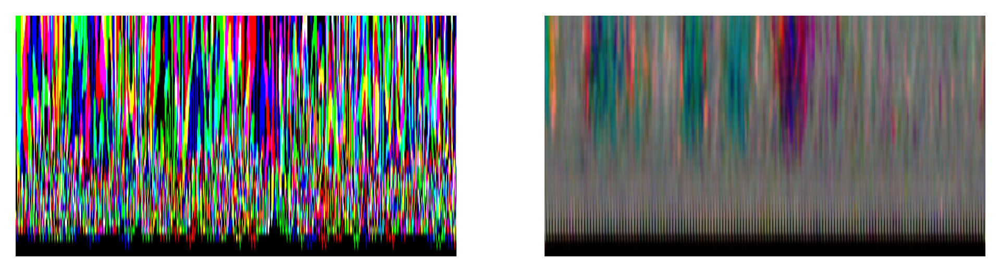

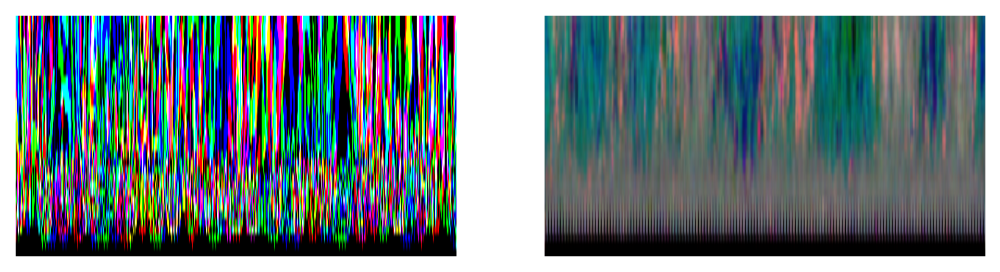

4 of 214 in 25.74 minutes. Using 14.4 of RAM
RAM after AllData: 14.5


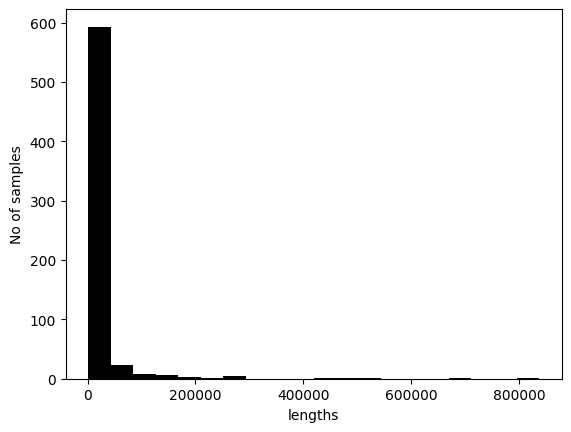

RAM after Keeps: 15.4
<class 'list'>
float32
(10813, 32, 600, 3)
RAM memory % used: 15.5


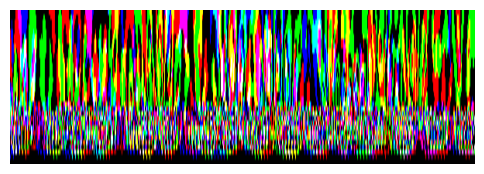

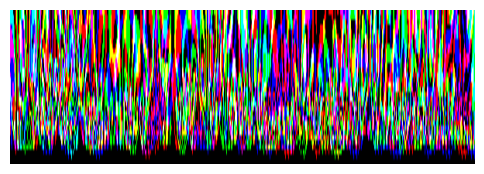

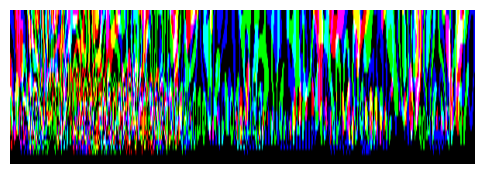

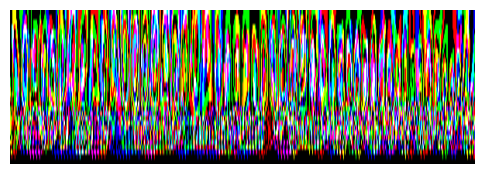

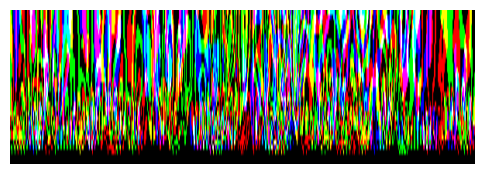

RAM after Prints: 17.0
Epoch 1/20
305/305 ━━━━━━━━━━━━━━━━━━━━ 9s 28ms/step - loss: 0.2068 - val_loss: 0.2069
Epoch 2/20
305/305 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step - loss: 0.2059 - val_loss: 0.2063
Epoch 3/20
305/305 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step - loss: 0.2057 - val_loss: 0.2062
Epoch 4/20
305/305 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step - loss: 0.2055 - val_loss: 0.2062
Epoch 5/20
305/305 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step - loss: 0.2054 - val_loss: 0.2062
Epoch 6/20
305/305 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step - loss: 0.2056 - val_loss: 0.2061
Epoch 7/20
305/305 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step - loss: 0.2051 - val_loss: 0.2061
Epoch 8/20
305/305 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step - loss: 0.2050 - val_loss: 0.2063
Epoch 9/20
305/305 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step - loss: 0.2048 - val_loss: 0.2061
Epoch 10/20
305/305 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step - loss: 0.2050 - val_loss: 0.2063
Epoch 11/20
305/305 ━━━━━━━━━━━━━━━━━━━━ 5s 15ms/step - loss: 0.2049 - val_loss: 0.2063
Epoch 12/20
305/30

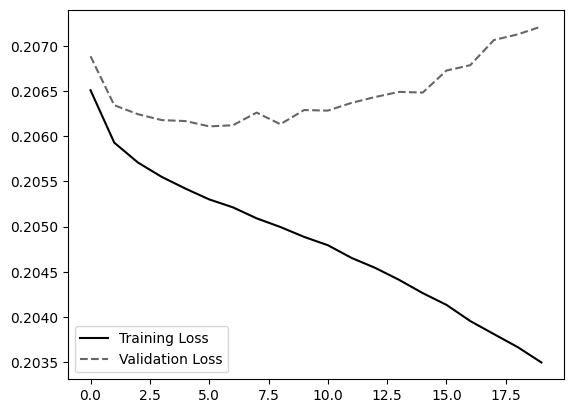

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


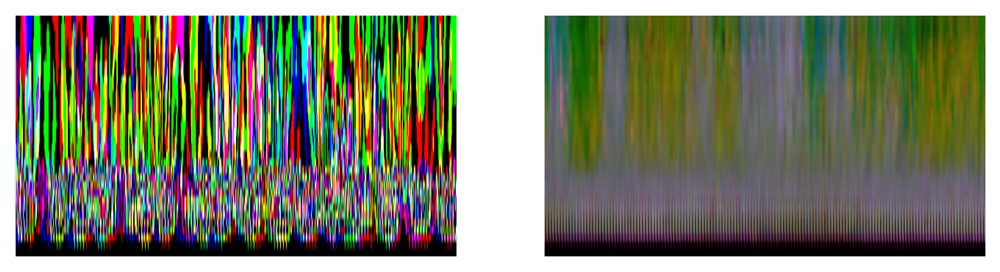

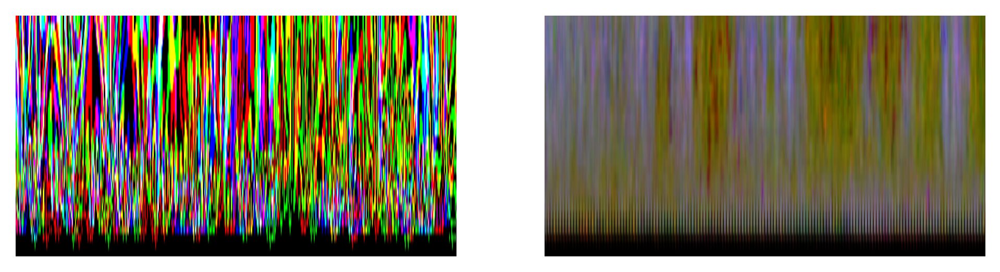

5 of 214 in 33.06 minutes. Using 15.6 of RAM
RAM after AllData: 16.6


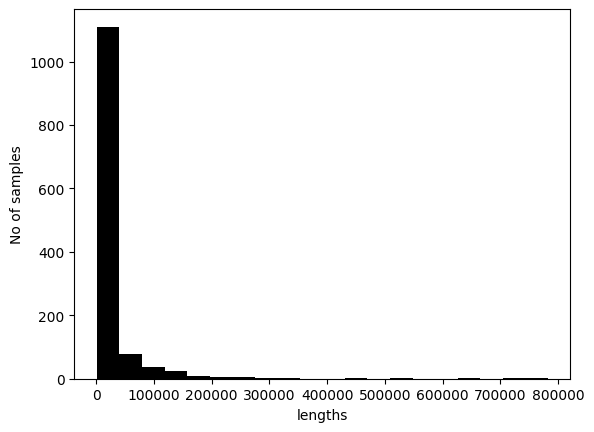

RAM after Keeps: 20.8
<class 'list'>
float32
(23578, 32, 600, 3)
RAM memory % used: 20.8


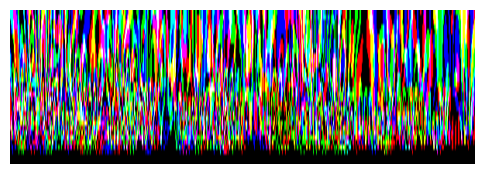

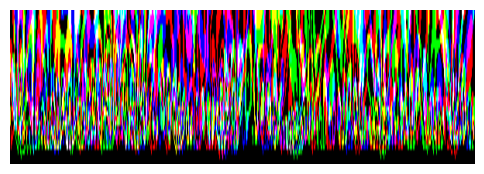

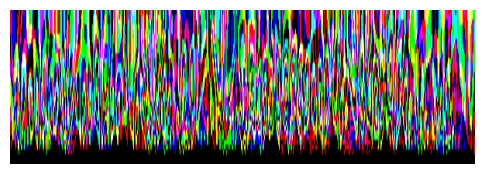

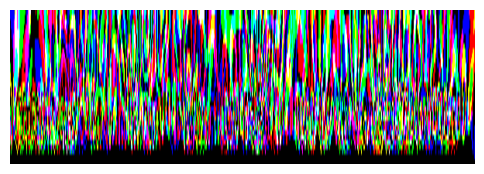

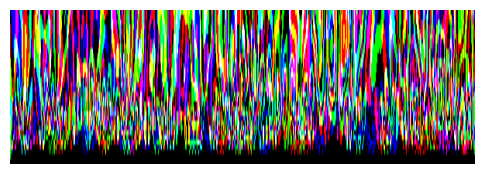

RAM after Prints: 24.7
Epoch 1/20
664/664 ━━━━━━━━━━━━━━━━━━━━ 15s 22ms/step - loss: 0.2063 - val_loss: 0.2060
Epoch 2/20
664/664 ━━━━━━━━━━━━━━━━━━━━ 11s 16ms/step - loss: 0.2058 - val_loss: 0.2059
Epoch 3/20
664/664 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.2056 - val_loss: 0.2061
Epoch 4/20
664/664 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.2055 - val_loss: 0.2060
Epoch 5/20
664/664 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.2055 - val_loss: 0.2065
Epoch 6/20
664/664 ━━━━━━━━━━━━━━━━━━━━ 10s 15ms/step - loss: 0.2054 - val_loss: 0.2060
Epoch 7/20
664/664 ━━━━━━━━━━━━━━━━━━━━ 10s 15ms/step - loss: 0.2053 - val_loss: 0.2066
Epoch 8/20
664/664 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.2052 - val_loss: 0.2062
Epoch 9/20
664/664 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.2049 - val_loss: 0.2063
Epoch 10/20
664/664 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.2048 - val_loss: 0.2067
Epoch 11/20
664/664 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.2047 - val_loss: 0.2067
Epoch 1

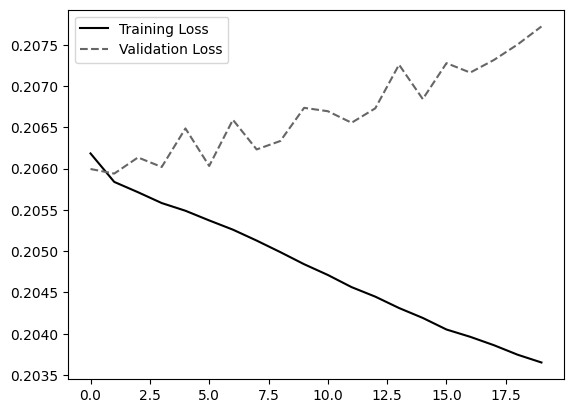

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


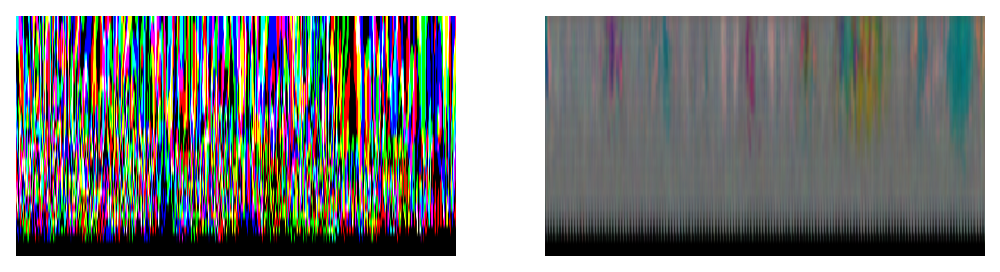

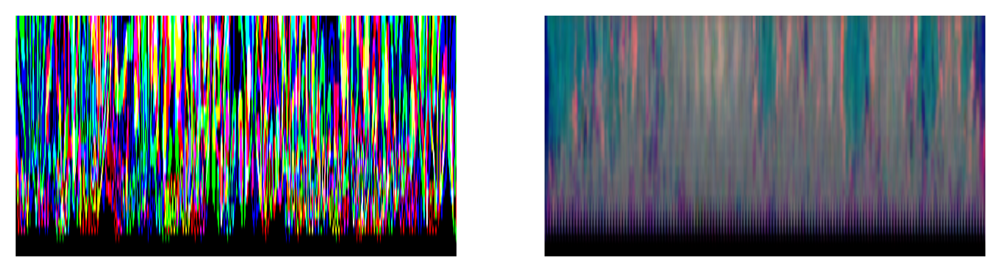

6 of 214 in 42.72 minutes. Using 15.0 of RAM


/sciclone/home/dchendrickson01/miniconda3/lib/python3.12/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/sciclone/home/dchendrickson01/miniconda3/lib/python3.12/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


RAM after AllData: 15.2


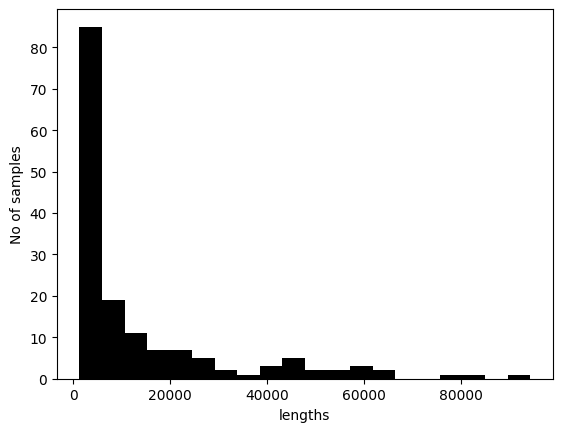

RAM after Keeps: 15.9
<class 'list'>
float32
(1723, 32, 600, 3)
RAM memory % used: 16.2


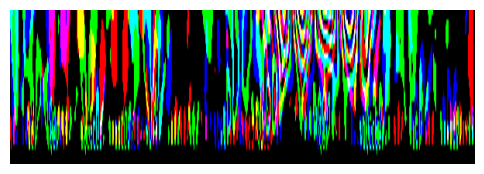

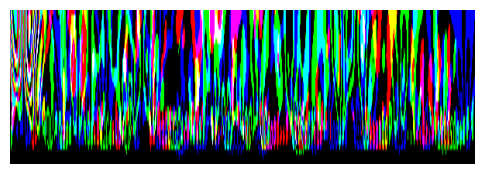

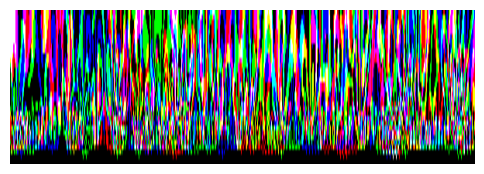

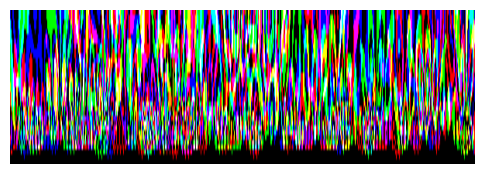

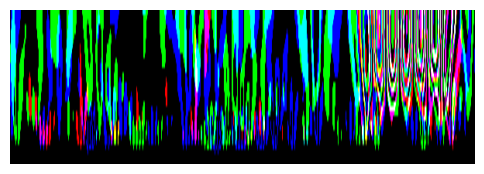

RAM after Prints: 16.2
Epoch 1/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 5s 97ms/step - loss: 0.1909 - val_loss: 0.1963
Epoch 2/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.1880 - val_loss: 0.1937
Epoch 3/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.1885 - val_loss: 0.1916
Epoch 4/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.1870 - val_loss: 0.1913
Epoch 5/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.1869 - val_loss: 0.1912
Epoch 6/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.1866 - val_loss: 0.1912
Epoch 7/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.1856 - val_loss: 0.1915
Epoch 8/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.1884 - val_loss: 0.1918
Epoch 9/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.1861 - val_loss: 0.1917
Epoch 10/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.1863 - val_loss: 0.1922
Epoch 11/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.1858 - val_loss: 0.1924
Epoch 12/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 1

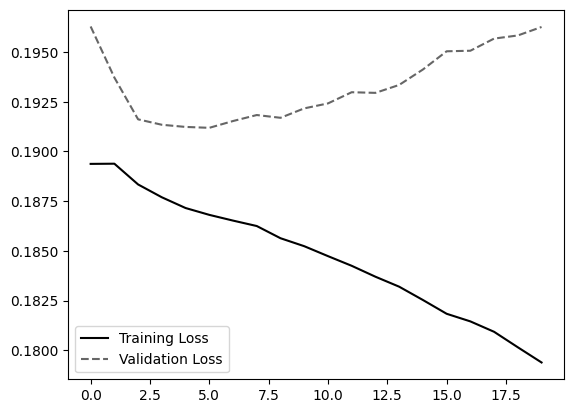

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


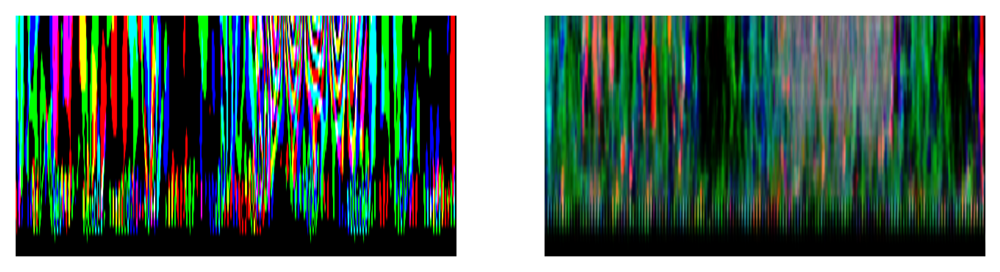

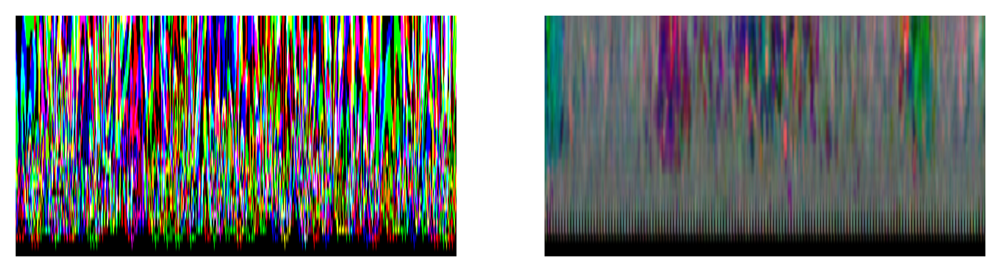

7 of 214 in 47.98 minutes. Using 15.7 of RAM
RAM after AllData: 15.7


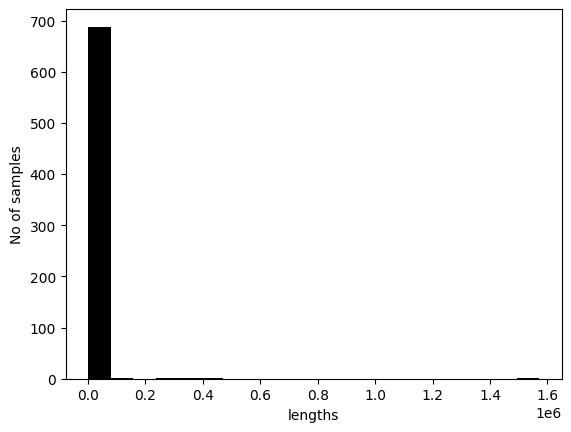

RAM after Keeps: 18.2
<class 'list'>
float32
(7520, 32, 600, 3)
RAM memory % used: 19.5


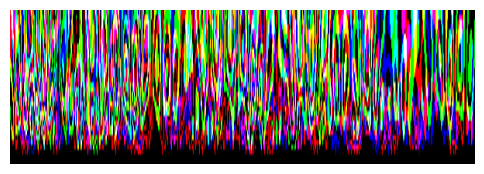

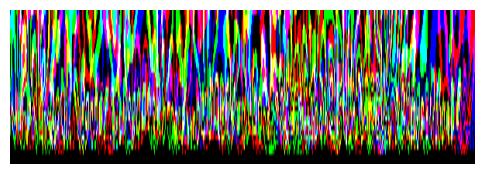

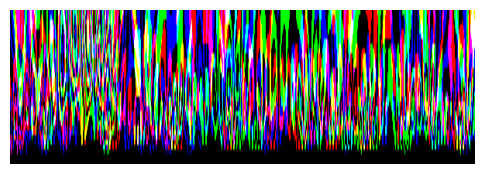

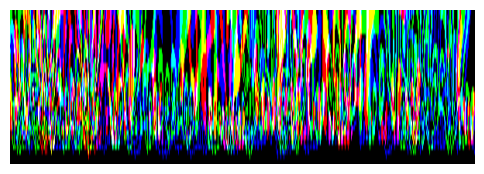

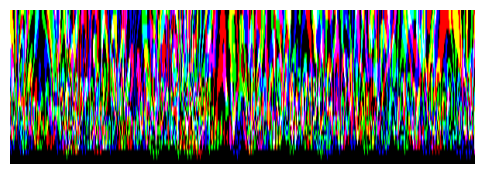

RAM after Prints: 19.5
Epoch 1/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - loss: 0.2027 - val_loss: 0.2026
Epoch 2/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.2013 - val_loss: 0.2022
Epoch 3/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 3s 15ms/step - loss: 0.2013 - val_loss: 0.2021
Epoch 4/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.2007 - val_loss: 0.2020
Epoch 5/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 3s 15ms/step - loss: 0.2010 - val_loss: 0.2020
Epoch 6/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.2003 - val_loss: 0.2020
Epoch 7/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 3s 15ms/step - loss: 0.2006 - val_loss: 0.2021
Epoch 8/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.2004 - val_loss: 0.2021
Epoch 9/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 3s 15ms/step - loss: 0.2004 - val_loss: 0.2021
Epoch 10/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.2003 - val_loss: 0.2022
Epoch 11/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.2000 - val_loss: 0.2022
Epoch 12/20
212/21

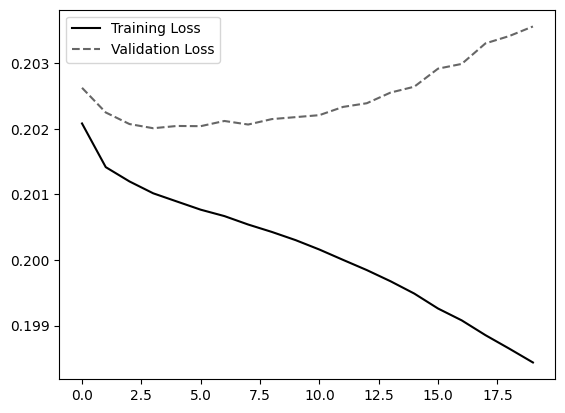

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


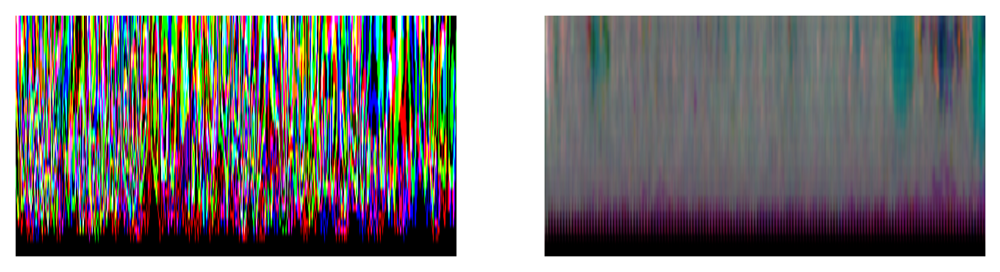

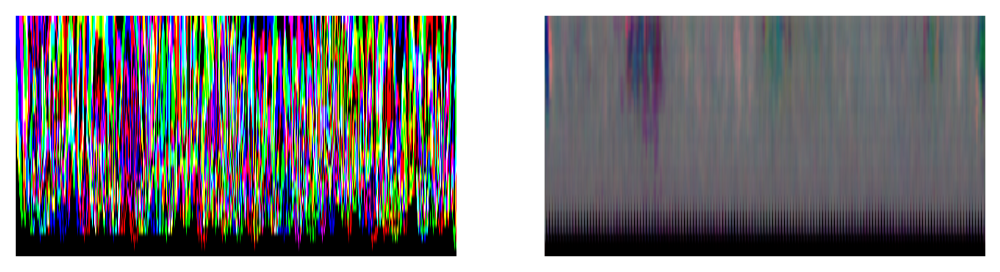

8 of 214 in 54.45 minutes. Using 21.0 of RAM
RAM after AllData: 20.9


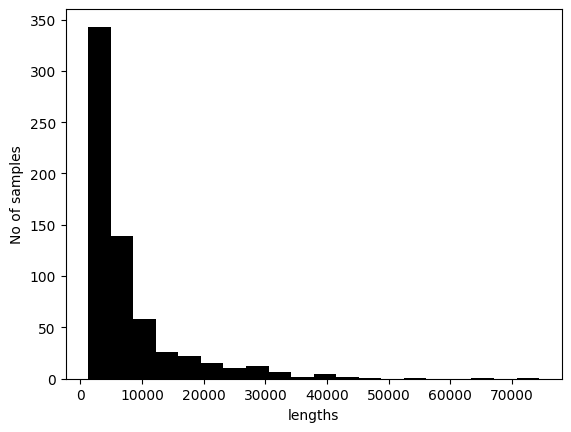

RAM after Keeps: 21.3
<class 'list'>
float32
(3757, 32, 600, 3)
RAM memory % used: 21.5


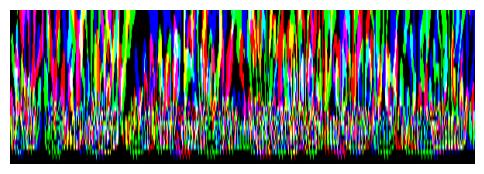

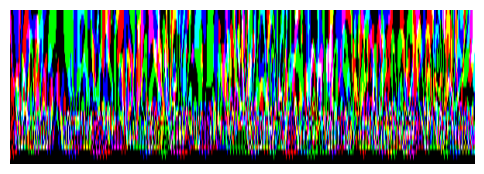

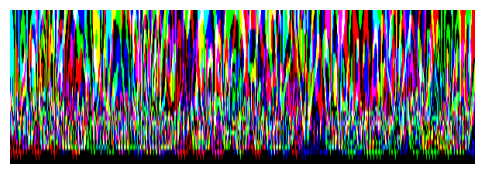

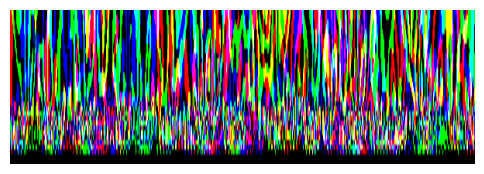

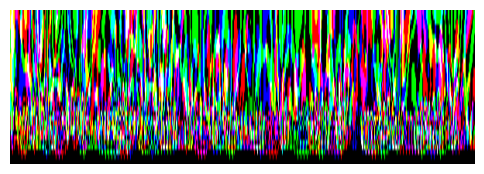

RAM after Prints: 21.2
Epoch 1/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 5s 48ms/step - loss: 0.2035 - val_loss: 0.2050
Epoch 2/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 0.2026 - val_loss: 0.2037
Epoch 3/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 0.2027 - val_loss: 0.2030
Epoch 4/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 0.2022 - val_loss: 0.2030
Epoch 5/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 0.2023 - val_loss: 0.2029
Epoch 6/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 0.2023 - val_loss: 0.2030
Epoch 7/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 0.2021 - val_loss: 0.2030
Epoch 8/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 0.2016 - val_loss: 0.2030
Epoch 9/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 0.2019 - val_loss: 0.2030
Epoch 10/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 0.2013 - val_loss: 0.2031
Epoch 11/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 0.2015 - val_loss: 0.2032
Epoch 12/20
106/10

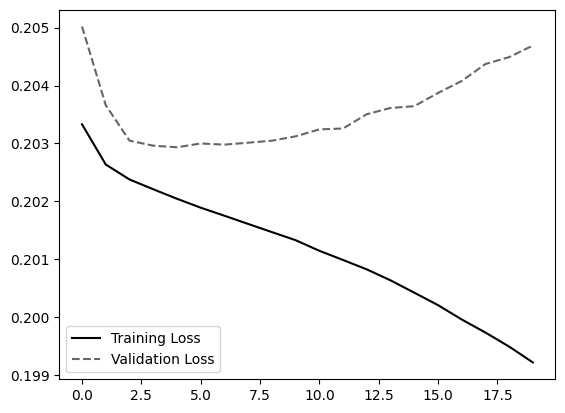

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


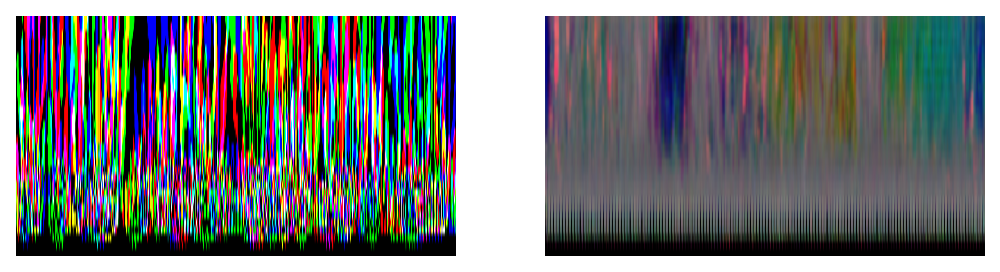

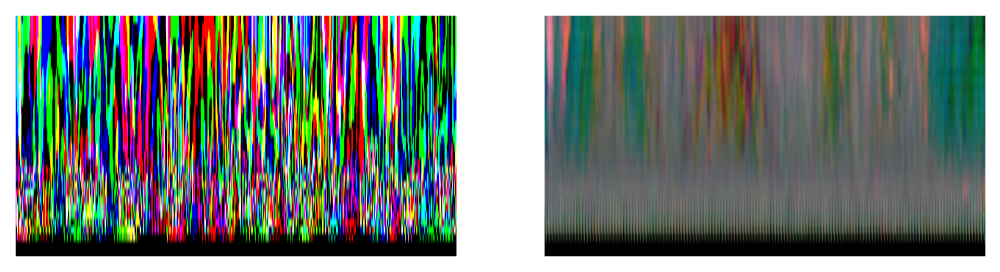

9 of 214 in 60.41 minutes. Using 21.8 of RAM
RAM after AllData: 21.6


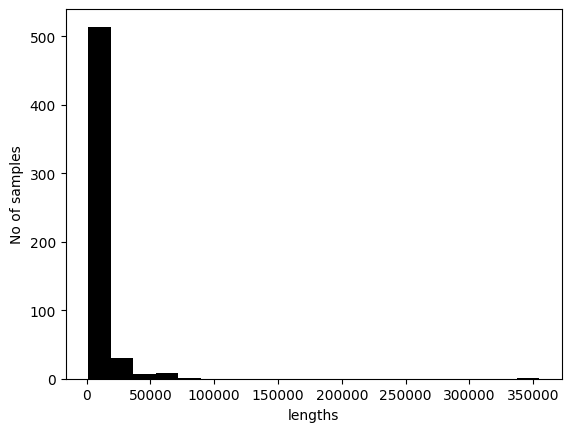

RAM after Keeps: 21.9
<class 'list'>
float32
(3323, 32, 600, 3)
RAM memory % used: 21.9


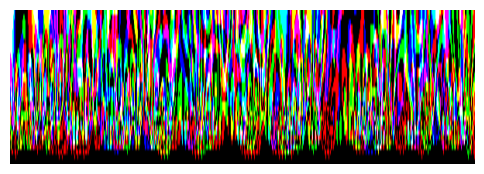

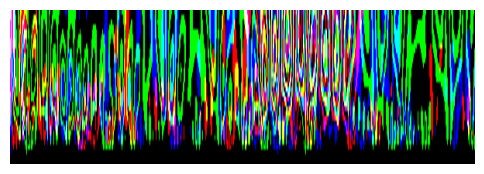

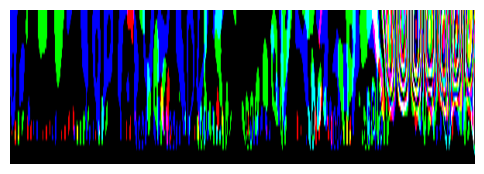

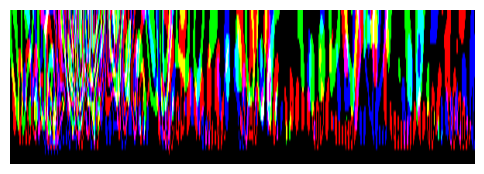

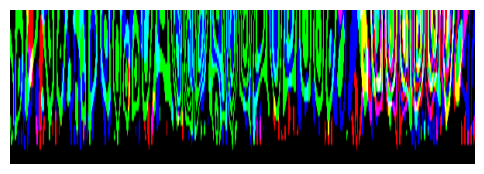

RAM after Prints: 21.9
Epoch 1/20
94/94 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 0.1923 - val_loss: 0.1944
Epoch 2/20
94/94 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.1907 - val_loss: 0.1932
Epoch 3/20
94/94 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 0.1921 - val_loss: 0.1934
Epoch 4/20
94/94 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 0.1907 - val_loss: 0.1929
Epoch 5/20
94/94 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 0.1909 - val_loss: 0.1927
Epoch 6/20
94/94 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 0.1897 - val_loss: 0.1927
Epoch 7/20
94/94 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 0.1919 - val_loss: 0.1928
Epoch 8/20
94/94 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.1899 - val_loss: 0.1928
Epoch 9/20
94/94 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 0.1896 - val_loss: 0.1928
Epoch 10/20
94/94 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 0.1896 - val_loss: 0.1929
Epoch 11/20
94/94 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 0.1891 - val_loss: 0.1930
Epoch 12/20
94/94 ━━━━━━━━━━━━━━━━━━━━ 2

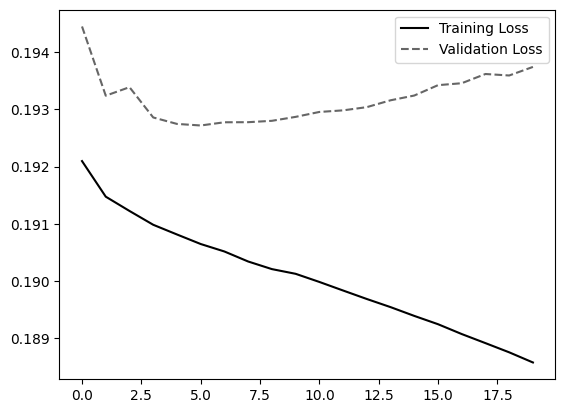

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


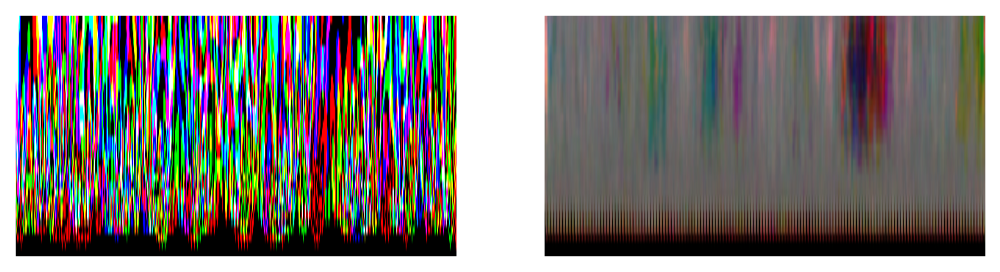

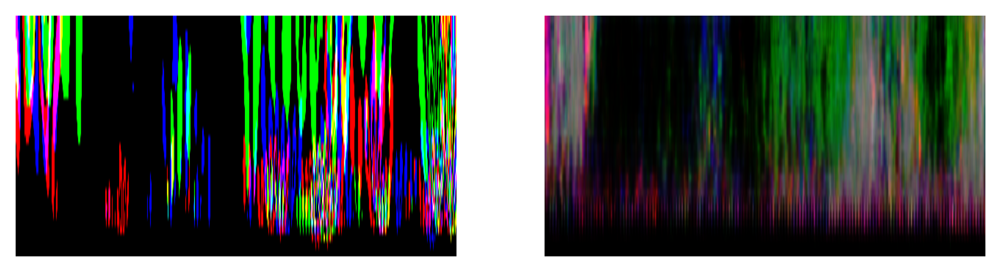

10 of 214 in 67.36 minutes. Using 22.4 of RAM
RAM after AllData: 22.5


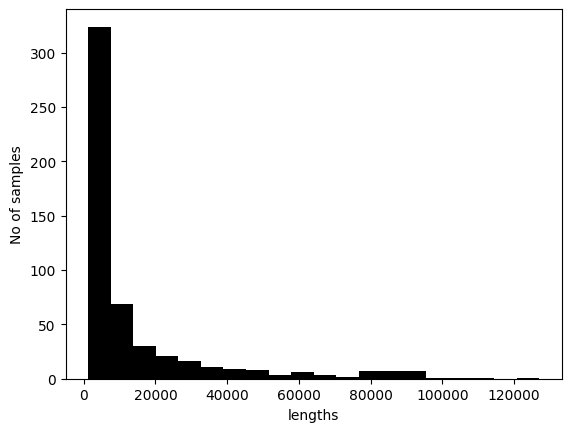

RAM after Keeps: 22.2
<class 'list'>
float32
(6102, 32, 600, 3)
RAM memory % used: 22.2


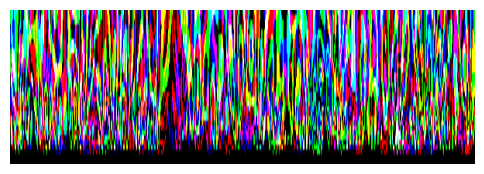

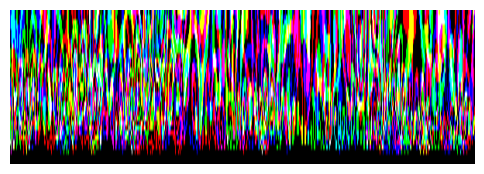

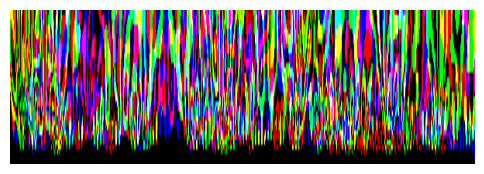

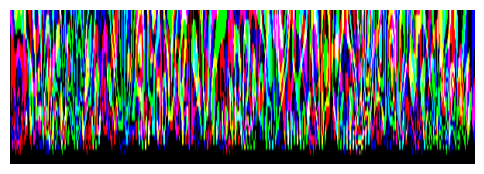

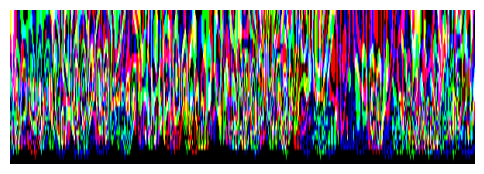

RAM after Prints: 22.1
Epoch 1/20
172/172 ━━━━━━━━━━━━━━━━━━━━ 6s 37ms/step - loss: 0.2082 - val_loss: 0.2084
Epoch 2/20
172/172 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.2075 - val_loss: 0.2072
Epoch 3/20
172/172 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.2072 - val_loss: 0.2071
Epoch 4/20
172/172 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.2072 - val_loss: 0.2071
Epoch 5/20
172/172 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.2068 - val_loss: 0.2072
Epoch 6/20
172/172 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.2072 - val_loss: 0.2074
Epoch 7/20
172/172 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.2068 - val_loss: 0.2073
Epoch 8/20
172/172 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.2061 - val_loss: 0.2073
Epoch 9/20
172/172 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.2066 - val_loss: 0.2075
Epoch 10/20
172/172 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.2064 - val_loss: 0.2075
Epoch 11/20
172/172 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.2058 - val_loss: 0.2076
Epoch 12/20
172/17

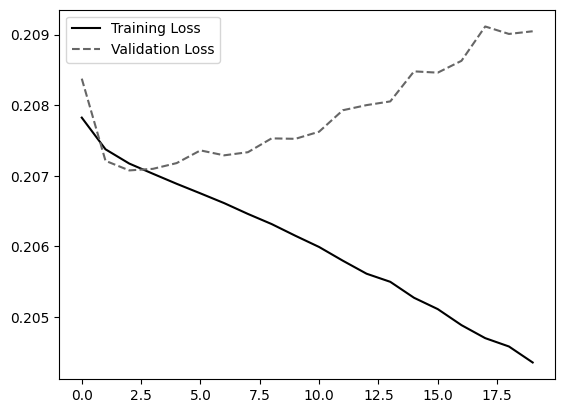

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


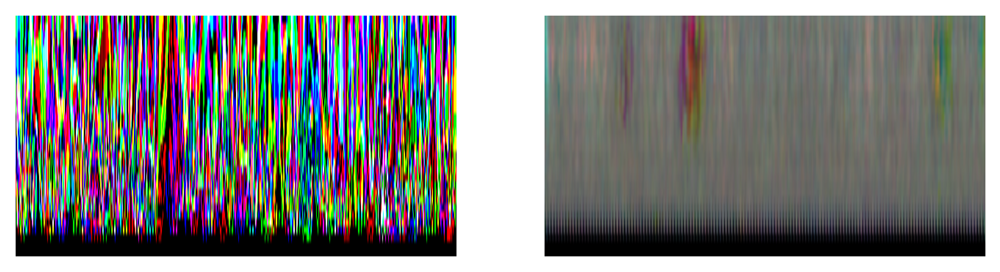

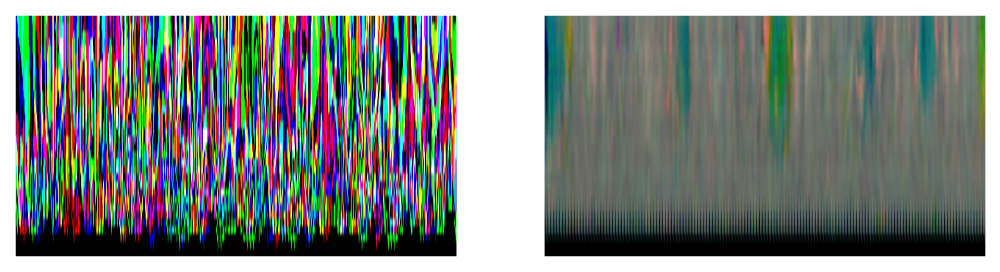

11 of 214 in 73.85 minutes. Using 22.0 of RAM


KeyboardInterrupt: 

In [18]:
toc=ti()

if RunTwice:
    LoopsToGetAll = int(len(files)/FilesPerRun)-LastSuccesfull-1
    print(f'Loops Needed: {LoopsToGetAll}')
else:
    LoopsToGetAll = 1
    
for j in range(LoopsToGetAll):
    j+=1+LastSuccesfull
    Mats=[]
    AllDatas = Parallel(n_jobs=ConcurrentFiles)(delayed(runWrapper)(files[(j*FilesPerRun+i)], 
                                                                    M_or_S = 'M', 
                                                                    verbose = False, 
                                                                    small = False, 
                                                                    r_time = False, 
                                                                    Four_D = False, 
                                                                    index=0, 
                                                                    start=toc
                                                                   ) for i in range(FilesPerRun))
    
    for fileResponse in AllDatas:
        for Mat in fileResponse:
            Mats.append(Mat)
    
    if MemoryProtection:
        del AllDatas
        print('RAM after AllData:', psutil.virtual_memory()[2])        
    lengths = []
    rejects = []
    Keeps = []

    for Mat in Mats:
        spm = np.shape(Mat)
        if len(spm) > 1:
            lenM = spm[1]
        else:
            lenM = 1
        if (lenM > 1250):
            lengths.append(lenM)
            Keeps.append(Mat)
        else:
            rejects.append(lenM)
    if verbose:
        plt.hist(lengths, bins=20)
        plt.xlabel("lengths")
        plt.ylabel("No of samples")
        plt.show()

    if MemoryProtection:
        del Mats
    
    AllPrints = Parallel(n_jobs=8)(delayed(PrintWrap)(Mat) for Mat in Keeps)
    
    if MemoryProtection:
        del Keeps
        print('RAM after Keeps:', psutil.virtual_memory()[2])

    Prints = []
    for group in AllPrints:
        for fprint in group:
            Prints.append(fprint[:, ::2, :])
    
    if MemoryProtection:
        del AllPrints

    random.shuffle(Prints)

    if verbose:
        print(type(Prints))
        print(Prints[0].dtype)
        print(np.shape(Prints))
        print('RAM memory % used:', psutil.virtual_memory()[2])
    
    for i, image in enumerate(Prints):
        if not isinstance(image, np.ndarray):
            Prints[i] = np.array(image, dtype=np.float32)
        elif image.dtype != np.float32:
            Prints[i] = image.astype(np.float32)
    
    if verbose:
        for i in range(5):
            fig = plt.figure(figsize=(6,2), dpi=100)
            plt.axis("off")
            plt.imshow(Prints[i*13], origin='lower',aspect='auto')
            plt.show()

    # Stack the images into a single NumPy array
    prints_array = np.stack(Prints, axis=0)

    
    if MemoryProtection:
        del Prints
        print('RAM after Prints:', psutil.virtual_memory()[2])
    

    #if more than half of memory is in use, will not be able to make tensor, so cut the array size accordingly
    if psutil.virtual_memory()[2] > 49:
        temp = (float(psutil.virtual_memory()[2]) - 50.0) / 50.0
        temp2 = int(np.shape(prints_array)[0]*temp)
        prints_array = prints_array[:temp2]

    # Convert the NumPy array to a TensorFlow tensor
    trX = tf.convert_to_tensor(prints_array)
    
    if MemoryProtection:
        del prints_array
    
    ImageShape = np.shape(trX)
    
    checkpoint_callback = CustomModelCheckpoint(
        filepath='/scratch/models/3DFP_'+DateString+'_'+str(j)+'_{epoch:02d}.keras',
        save_freq=3  
    )
    
    H = autoencoder.fit(
        trX, trX,
        validation_split=0.1,
        epochs=20,
        #callbacks=[checkpoint_callback, es_callback],     
        batch_size=BS)
    
    plt.plot(H.history["loss"], label="Training Loss")
    plt.plot(H.history["val_loss"], label="Validation Loss")
    plt.legend()
    plt.show()

    #random.shuffle(trX)
    autoencoder.save('/scratch/models/3DFP_'+DateString+'_'+str(j).zfill(3)+'_good_ae.keras')
    encoder.save('/scratch/models/3DFP_'+DateString+'_'+str(j).zfill(3)+'_good_en.keras')
    decoder.save('/scratch/models/3DFP_'+DateString+'_'+str(j).zfill(3)+'_good_de.keras')

    
    x_train_pred = autoencoder.predict(trX[:2])
    
    for i in range(2):
        fig, (ax1, ax2) = plt.subplots(1,2,figsize=(8,2), dpi=300 )
        ax1.imshow(trX[i], origin='lower',aspect='auto')
        ax1.axis("off")
        ax2.imshow(x_train_pred[i], origin='lower',aspect='auto')
        ax2.axis("off")
        plt.show()

    del trX, x_train_pred, fig, ax1,ax2
    gc.collect()

    if j%LR_PeriodGrow == 0:
        LR_Current *= LR_Expand
    else:
        LR_Current *= LR_Decay
        
    autoencoder.optimizer.learning_rate = LR_Current

    print(f'{j} of {LoopsToGetAll} in {int((ti()-toc)/.6)/100} minutes. Using { psutil.virtual_memory()[2]} of RAM')